# Spark project

In [1]:
from pyspark.context import SparkContext
from pyspark.sql.session import SparkSession
sc = SparkContext('local')
spark = SparkSession(sc)

# Find the sample dataset of request logs in data/DataSample.csv

In [2]:
df=spark.read.format("csv").option("header","true").load("data/DataSample.csv")

In [3]:
df.head(3)

[Row(_ID='4516516',  TimeSt='2017-06-21 00:00:00.143', Country='CA', Province='ON', City='Waterloo', Latitude='43.49347', Longitude='-80.49123'),
 Row(_ID='4516547',  TimeSt='2017-06-21 18:00:00.193', Country='CA', Province='ON', City='London', Latitude='42.93990', Longitude='-81.27090'),
 Row(_ID='4516550',  TimeSt='2017-06-21 15:00:00.287', Country='CA', Province='ON', City='Guelph', Latitude='43.57760', Longitude='-80.22010')]

# Intial drop

In [4]:
df.dropDuplicates().show()

+-------+--------------------+-------+--------+------------------+--------+----------+
|    _ID|              TimeSt|Country|Province|              City|Latitude| Longitude|
+-------+--------------------+-------+--------+------------------+--------+----------+
|4535906|2017-06-21 03:01:...|     CA|      ON|            Whitby|43.88660| -78.97500|
|4536301|2017-06-21 22:01:...|     CA|      AB|             Leduc|53.26170|-113.54900|
|4543837|2017-06-21 21:01:...|     CA|      ON|     Sioux Lookout|50.09790| -91.92200|
|4555569|2017-06-21 21:01:...|     CA|      ON|         Kitchener|43.44430| -80.48910|
|4563278|2017-06-21 05:01:...|     CA|      ON|       Thunder Bay|48.42050| -89.23710|
|4570499|2017-06-21 00:01:...|     CA|      ON|         North Bay|46.33770| -79.37170|
|4579260|2017-06-21 08:02:...|     CA|      AB|           Calgary|51.04940|-113.95640|
|4585618|2017-06-21 05:02:...|     CA|      AB|           Calgary|50.93160|-114.09600|
|4598014|2017-06-21 14:03:...|     CA|     

In [5]:
df=df.dropDuplicates()

In [6]:
df.show(100)

+-------+--------------------+-------+--------+------------------+--------+----------+
|    _ID|              TimeSt|Country|Province|              City|Latitude| Longitude|
+-------+--------------------+-------+--------+------------------+--------+----------+
|4535906|2017-06-21 03:01:...|     CA|      ON|            Whitby|43.88660| -78.97500|
|4536301|2017-06-21 22:01:...|     CA|      AB|             Leduc|53.26170|-113.54900|
|4543837|2017-06-21 21:01:...|     CA|      ON|     Sioux Lookout|50.09790| -91.92200|
|4555569|2017-06-21 21:01:...|     CA|      ON|         Kitchener|43.44430| -80.48910|
|4563278|2017-06-21 05:01:...|     CA|      ON|       Thunder Bay|48.42050| -89.23710|
|4570499|2017-06-21 00:01:...|     CA|      ON|         North Bay|46.33770| -79.37170|
|4579260|2017-06-21 08:02:...|     CA|      AB|           Calgary|51.04940|-113.95640|
|4585618|2017-06-21 05:02:...|     CA|      AB|           Calgary|50.93160|-114.09600|
|4598014|2017-06-21 14:03:...|     CA|     

# Drop Columns where Longitude, Latitude and TimeSet are same

In [7]:
df=df.dropDuplicates([' TimeSt', 'Latitude','Longitude'])

In [8]:
df.show(1000)

+-------+--------------------+-------+--------+--------------------+--------+----------+
|    _ID|              TimeSt|Country|Province|                City|Latitude| Longitude|
+-------+--------------------+-------+--------+--------------------+--------+----------+
|4516516|2017-06-21 00:00:...|     CA|      ON|            Waterloo|43.49347| -80.49123|
|4519209|2017-06-21 00:00:...|     CA|      ON|             Hanover|44.15170| -81.02660|
|4518130|2017-06-21 00:00:...|     CA|      ON|              London|43.00040| -81.23430|
|5368841|2017-06-21 00:00:...|     CA|      ON|              Nepean|45.27780| -75.75630|
|4521574|2017-06-21 00:00:...|     CA|      ON|           Brantford|43.15080| -80.20940|
|4523455|2017-06-21 00:00:...|     CA|      ON|              London|43.00910| -81.17650|
|4522231|2017-06-21 00:00:...|     CA|      ON|             Chatham|42.42470| -82.17550|
|4522376|2017-06-21 00:00:...|     CA|      ON|            Waterloo|43.46340| -80.52010|
|4524947|2017-06-21 0

In [9]:
df.dtypes

[('_ID', 'string'),
 (' TimeSt', 'string'),
 ('Country', 'string'),
 ('Province', 'string'),
 ('City', 'string'),
 ('Latitude', 'string'),
 ('Longitude', 'string')]

In [10]:
cols=['Latitude','Longitude']
from pyspark.sql.functions import col

for col_name in cols:
    df = df.withColumn(col_name, col(col_name).cast('float'))

In [11]:
df.dtypes

[('_ID', 'string'),
 (' TimeSt', 'string'),
 ('Country', 'string'),
 ('Province', 'string'),
 ('City', 'string'),
 ('Latitude', 'float'),
 ('Longitude', 'float')]

In [12]:
## Latitude must be less then 90 and greater then -90
## Longitude must be in range -180 to 180

In [13]:
df=df.where(df.Latitude>-90)
df=df.where(df.Latitude<90)
df=df.where(df.Longitude>-180)
df=df.where(df.Longitude<90)

## Assign each *request* (from `data/DataSample.csv`) to the closest (i.e., minimum distance) *POI* (from `data/POIList.csv`).

## Note: a *POI* is a geographical Point of Interest.

In [14]:
POI=spark.read.format("csv").option("header","true").load("data/POIList.csv")

In [15]:
POI.show()

+-----+----------+------------+
|POIID|  Latitude|   Longitude|
+-----+----------+------------+
| POI1| 53.546167| -113.485734|
| POI2| 53.546167| -113.485734|
| POI3| 45.521629|  -73.566024|
| POI4| 45.224830|  -63.232729|
+-----+----------+------------+



In [16]:
cols=[' Latitude','Longitude']
for col_name in cols:
    POI = POI.withColumn(col_name, col(col_name).cast('float'))

In [17]:
POI.select(" Latitude")

DataFrame[ Latitude: float]

In [18]:
POI.dtypes

[('POIID', 'string'), (' Latitude', 'float'), ('Longitude', 'float')]

In [19]:
POI.collect()[0][1] # POI1 Lat

53.546165466308594

In [20]:
POI.collect()[2][1]

45.521629333496094

In [21]:
POI.collect()[3][1]

45.224830627441406

In [22]:
POI.collect()[1][1]

53.546165466308594

In [23]:
POI.collect()[0][2] # POI Lot

-113.48573303222656

# The distance formula

In [24]:
from geopy.distance import geodesic
import pyspark.sql.functions as F
#import FloatType
from pyspark.sql.types import FloatType

@F.udf(returnType=FloatType())
def geodesic_udf(a, b):
    return geodesic(a, b).m

In [25]:
from geopy import distance
from pyspark.sql.functions import lit


In [26]:
df=df.withColumn('POI1_Lon', lit(POI.collect()[0][2]))
df=df.withColumn('POI1_Lat', lit(POI.collect()[0][1]))
df=df.withColumn('POI2_Lon', lit(POI.collect()[1][2]))
df=df.withColumn('POI2_Lat', lit(POI.collect()[1][1]))
df=df.withColumn('POI3_Lon', lit(POI.collect()[2][2]))
df=df.withColumn('POI3_Lat', lit(POI.collect()[2][1]))
df=df.withColumn('POI4_Lon', lit(POI.collect()[3][2]))
df=df.withColumn('POI4_Lat', lit(POI.collect()[3][1]))

In [27]:
df.show(10)

+-------+--------------------+-------+--------+---------+--------+---------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+
|    _ID|              TimeSt|Country|Province|     City|Latitude|Longitude|           POI1_Lon|          POI1_Lat|           POI2_Lon|          POI2_Lat|          POI3_Lon|          POI3_Lat|           POI4_Lon|          POI4_Lat|
+-------+--------------------+-------+--------+---------+--------+---------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+
|4516516|2017-06-21 00:00:...|     CA|      ON| Waterloo|43.49347|-80.49123|-113.48573303222656|53.546165466308594|-113.48573303222656|53.546165466308594|-73.56602478027344|45.521629333496094|-63.232730865478516|45.224830627441406|
|4519209|2017-06-21 00:00:...|     CA|      ON|  Hanover| 44.1517| -81.0

In [28]:
(F.array("Longitude", "Latitude"))

Column<'array(Longitude, Latitude)'>

In [29]:
DF = df.withColumn('POI1', geodesic_udf(F.array( "Latitude","Longitude"), F.array( "POI1_Lat","POI1_Lon")))
DF = DF.withColumn('POI2', geodesic_udf(F.array( "Latitude","Longitude"), F.array( "POI2_Lat","POI2_Lon")))
DF = DF.withColumn('POI3', geodesic_udf(F.array( "Latitude","Longitude"), F.array( "POI3_Lat","POI3_Lon")))
DF = DF.withColumn('POI4', geodesic_udf(F.array( "Latitude","Longitude"), F.array( "POI4_Lat","POI4_Lon")))

In [30]:
DF.show(10)

+-------+--------------------+-------+--------+---------+--------+---------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+---------+---------+---------+---------+
|    _ID|              TimeSt|Country|Province|     City|Latitude|Longitude|           POI1_Lon|          POI1_Lat|           POI2_Lon|          POI2_Lat|          POI3_Lon|          POI3_Lat|           POI4_Lon|          POI4_Lat|     POI1|     POI2|     POI3|     POI4|
+-------+--------------------+-------+--------+---------+--------+---------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+---------+---------+---------+---------+
|4516516|2017-06-21 00:00:...|     CA|      ON| Waterloo|43.49347|-80.49123|-113.48573303222656|53.546165466308594|-113.48573303222656|53.546165466308594|-73.56602478027344|45.52162933

In [31]:
#DF=DF.select('_ID', ' TimeSt','Country','Province','City','POI1','POI2','POI3','POI4')

In [32]:
from pyspark.sql import functions as F
DF = DF.withColumn("POI_MIN",F.least(*['POI1','POI2','POI3','POI4']))

In [33]:
cols = ['POI1','POI2','POI3','POI4']
col_string = ', '.join("'{0}'".format(c) for c in cols)

df1 = DF.withColumn("vals", F.array(cols)) \
    .withColumn("cols", F.expr("Array(" + col_string + ")")) \
    .withColumn("zipped", F.arrays_zip("vals", "cols")) \
    .withColumn("without_nulls", F.expr("filter(zipped, x -> not x.vals is null)")) \
    .withColumn("sorted", F.expr("array_sort(without_nulls)")) \
    .withColumn("POIID", F.col("sorted")[0].cols) \
    .drop("vals", "cols", "zipped", "without_nulls", "sorted")

#  Assign each request

In [34]:
df1.show(truncate=False)

+-------+-----------------------+-------+--------+-------------+--------+----------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+---------+---------+---------+---------+---------+-----+
|_ID    | TimeSt                |Country|Province|City         |Latitude|Longitude |POI1_Lon           |POI1_Lat          |POI2_Lon           |POI2_Lat          |POI3_Lon          |POI3_Lat          |POI4_Lon           |POI4_Lat          |POI1     |POI2     |POI3     |POI4     |POI_MIN  |POIID|
+-------+-----------------------+-------+--------+-------------+--------+----------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+---------+---------+---------+---------+---------+-----+
|4516516|2017-06-21 00:00:00.143|CA     |ON      |Waterloo     |43.49347|-80.49123 |-113.48573303222656|53.54616

# Data Science Track

### 3. Analysis

1. For each *POI*, calculate the average and standard deviation of the distance between the *POI* to each of its assigned *requests*.

In [35]:
#df1.groupBy((' ','')).agg(F.avg(F.col(""))).show()
from pyspark.sql.functions import count, avg

df1.groupBy(" TimeSt", "POIID").agg(avg("POI_MIN"), count("*")).show()


+--------------------+-----+---------------+--------+
|              TimeSt|POIID|   avg(POI_MIN)|count(1)|
+--------------------+-----+---------------+--------+
|2017-06-21 08:45:...| POI3|     530094.125|       1|
|2017-06-21 03:55:...| POI3|      1231888.0|       1|
|2017-06-21 16:04:...| POI3|     524404.375|       1|
|2017-06-21 02:03:...| POI1|    279670.0625|       1|
|2017-06-21 13:07:...| POI1|  171951.796875|       1|
|2017-06-21 00:59:...| POI1|   281232.90625|       1|
|2017-06-21 13:00:...| POI1|   347142.09375|       1|
|2017-06-21 10:19:...| POI3|    294706.9375|       1|
|2017-06-21 10:48:...| POI3|       497190.5|       1|
|2017-06-21 03:51:...| POI1|   277531.15625|       1|
|2017-06-21 12:19:...| POI3|    491784.4375|       1|
|2017-06-21 18:59:...| POI3|    527792.9375|       1|
|2017-06-21 18:17:...| POI3|      598879.75|       1|
|2017-06-21 11:33:...| POI1|       482171.0|       1|
|2017-06-21 20:19:...| POI1|     696706.875|       1|
|2017-06-21 16:58:...| POI3|

In [36]:
df1.groupBy(F.col('POIID')).agg(F.avg(F.col("POI_MIN"))).show()

+-----+------------------+
|POIID|      avg(POI_MIN)|
+-----+------------------+
| POI4|498359.27721886465|
| POI1|294307.39733632695|
| POI3| 452659.3783223412|
+-----+------------------+



In [37]:
df1.groupBy(F.col('POIID')).agg(F.stddev(F.col("POI_MIN"))).show()

+-----+--------------------+
|POIID|stddev_samp(POI_MIN)|
+-----+--------------------+
| POI4|  1476293.0234535674|
| POI1|   285694.8882316885|
| POI3|  224123.11933786827|
+-----+--------------------+



## At each POI, draw a circle (with the center at the POI) that includes all of its assigned requests. Calculate the radius and density (requests/area) for each POI.

## Select POIs and working on them individullay

In [38]:
df_POI1 = df1.filter(df1.POIID == 'POI1')

In [39]:
POI.collect()[0][2] # POI1 Lat

-113.48573303222656

In [40]:
df_POI1.show(10)

+-------+--------------------+-------+--------+----------------+--------+----------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+---------+---------+---------+---------+---------+-----+
|    _ID|              TimeSt|Country|Province|            City|Latitude| Longitude|           POI1_Lon|          POI1_Lat|           POI2_Lon|          POI2_Lat|          POI3_Lon|          POI3_Lat|           POI4_Lon|          POI4_Lat|     POI1|     POI2|     POI3|     POI4|  POI_MIN|POIID|
+-------+--------------------+-------+--------+----------------+--------+----------+-------------------+------------------+-------------------+------------------+------------------+------------------+-------------------+------------------+---------+---------+---------+---------+---------+-----+
|5377445|2017-06-21 00:00:...|     CA|      AB|         Calgary| 51.0494| -113.9564|-113.48573303222656|53.54616

# simple plot

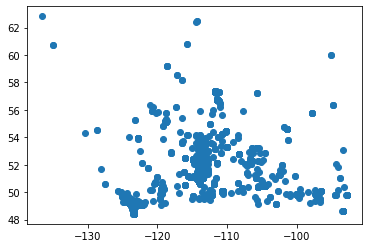

In [41]:
import matplotlib.pyplot as plt
plt.scatter(x=df_POI1.select('Longitude').collect(), y=df_POI1.select('Latitude').collect())
plt.show()

In [42]:
lon=df_POI1.select("Longitude").rdd.flatMap(lambda x: x).collect()
lat=df_POI1.select('Latitude').rdd.flatMap(lambda x: x).collect()

In [43]:
from pyspark.sql.functions import mean


In [44]:
count_df1=df_POI1.groupBy("City").agg(F.count('_ID'))

count_df1.select(mean('count(_ID)')).collect() # density

[Row(avg(count(_ID))=33.51379310344828)]

In [45]:
min(lon)

-136.53956604003906

In [46]:
max(lon)

-92.83439636230469

In [47]:
min(lat)

48.40732955932617

In [48]:
max(lat)

62.827301025390625

In [49]:
POI.collect()[0][1] # POI1 Lat

53.546165466308594

In [50]:
POI.collect()[0][2] # POI1 lon

-113.48573303222656

In [51]:
MAX_lat=max(abs(POI.collect()[0][1]-max(lat)) , abs(POI.collect()[0][1]-min(lat)))
MAX_LON=max(abs(POI.collect()[0][2]-max(lon)) , abs(POI.collect()[0][2]-min(lon)))

In [52]:
MAX_lat

9.281135559082031

In [53]:
MAX_LON

23.0538330078125

In [54]:
import numpy as np

In [55]:
radius=np.round(max(MAX_lat,MAX_LON)) #radius

In [56]:
radius

23.0

In [57]:
lat_lon=[[i, j] for i,j in zip(lat , lon )]

In [58]:
import folium

In [59]:
name=df_POI1.select('City').rdd.flatMap(lambda x: x).collect()

In [60]:
m=folium.Map(location=[53,-113],
      radius=radius,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   )

In [61]:
for i in range(0,len(lat_lon)):
    folium.Circle(
      location=[lat_lon[i][0],lat_lon[i][1]],
      popup=name[i],
      radius=1,
      color='crimson',
      fill=True).add_to(m)

In [62]:
folium.Circle(location=[53,-113],
      radius=radius*50000,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2').add_to(m)

In [63]:
m

# Working for POI_3

In [64]:
df_POI3 = df1.filter(df1.POIID == 'POI3')

In [65]:
count_df3=df_POI3.groupBy("City").agg(F.count('_ID'))

count_df3.select(mean('count(_ID)')).collect() # density

[Row(avg(count(_ID))=32.54485049833887)]

In [66]:
lon=df_POI3.select("Longitude").rdd.flatMap(lambda x: x).collect()
lat=df_POI3.select('Latitude').rdd.flatMap(lambda x: x).collect()

In [67]:
MAX_lat=max(abs(POI.collect()[2][1]-max(lat)) , abs(POI.collect()[2][1]-min(lat)))
MAX_LON=max(abs(POI.collect()[2][2]-max(lon)) , abs(POI.collect()[2][2]-min(lon)))
radius=np.round(max(MAX_lat,MAX_LON)) #radius

In [68]:
radius

19.0

In [69]:
lat_lon=[[i, j] for i,j in zip(lat , lon )]

In [70]:
name=df_POI3.select('City').rdd.flatMap(lambda x: x).collect()

In [71]:
m1=folium.Map(location=[45,-73],
      radius=radius,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   )

In [72]:
for i in range(0,len(lat_lon)):
    folium.Circle(
      location=[lat_lon[i][0],lat_lon[i][1]],
      popup=name[i],
      radius=1,
      color='crimson',
      fill=True).add_to(m1)

In [73]:
folium.Circle(location=[45,-73],
      radius=radius*50000,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2').add_to(m1)

In [74]:
m1

# Working for POI4

In [75]:
df_POI4 = df1.filter(df1.POIID == 'POI4')
count_df4=df_POI4.groupBy("City").agg(F.count('_ID'))

count_df4.select(mean('count(_ID)')).collect() # density

[Row(avg(count(_ID))=6.534246575342466)]

In [76]:
lon=df_POI4.select("Longitude").rdd.flatMap(lambda x: x).collect()
lat=df_POI4.select('Latitude').rdd.flatMap(lambda x: x).collect()

In [77]:

MAX_lat=max(abs(POI.collect()[3][1]-max(lat)) , abs(POI.collect()[3][1]-min(lat)))
MAX_LON=max(abs(POI.collect()[3][2]-max(lon)) , abs(POI.collect()[3][2]-min(lon)))
radius=np.round(max(MAX_lat,MAX_LON)) #radius
radius

115.0

In [78]:
lat_lon=[[i, j] for i,j in zip(lat , lon )]
name=df_POI3.select('City').rdd.flatMap(lambda x: x).collect()

In [79]:
m2=folium.Map(location=[45,-63],
      radius=radius,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   )

In [80]:
for i in range(0,len(lat_lon)):
    folium.Circle(
      location=[lat_lon[i][0],lat_lon[i][1]],
      popup=name[i],
      radius=1,
      color='crimson',
      fill=True).add_to(m2)

In [81]:
folium.Circle(location=[45,-63],
      radius=radius*50000,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2').add_to(m2)

In [82]:
m2

### Modelling

1. To visualize the popularity of each *POI*, map them to a scale that ranges from -10 to 10. Please provide a mathematical model to implement this, considering extreme cases and outliers. Aim to be more sensitive around the average and give as much visual differentiability as possible.
2. **Bonus**: Try to develop reasonable hypotheses regarding *POIs*, state all assumptions, testing steps, and conclusions. Include this as a text file (with the name `bonus`) in your final submission.



In [83]:
DF_1=df_POI1.select('_ID', ' TimeSt','Country','Province','City','POI1','Longitude','Latitude')
DF_3=df_POI3.select('_ID', ' TimeSt','Country','Province','City','POI3','Longitude','Latitude')
DF_4=df_POI3.select('_ID', ' TimeSt','Country','Province','City','POI4','Longitude','Latitude')

## IQR Method to remove outliers

In [84]:
DF_1.select('POI1').describe().show()

+-------+------------------+
|summary|              POI1|
+-------+------------------+
|  count|              9719|
|   mean|294307.39733632695|
| stddev| 285694.8882316885|
|    min|         349.62354|
|    max|         1689530.4|
+-------+------------------+



In [85]:
DF_1.approxQuantile("POI1", [0.5], 0.25)

[15251.9267578125]

In [86]:
DF_1.approxQuantile("POI1", [0.9],0.2)

[1689530.375]

In [89]:
DF_1.approxQuantile("POI1", [0.1],0.2)

[349.62353515625]

In [90]:
DF_1.approxQuantile("POI1", [0.75],0.2)

[282025.34375]

### Upon Ananlsysis we choose 0.75 as final value

## Most the values belongs to 3rd Quartile

In [91]:
Q1 = DF_1.approxQuantile("POI1", [0.25],0.1)[0]
Q3 = DF_1.approxQuantile("POI1", [0.75],0.1)[0]
IQR = Q3 - Q1

In [92]:
IQR

254352.060546875

# Since we need to be sensative about the average so either select average or IQR

In [93]:
or_mean=DF_1.select(mean('POI1')).rdd.flatMap(lambda x: x).collect()

In [94]:
threshold=max(or_mean[0],IQR)

## Removing Outliers

In [95]:
df_P1 = DF_1.filter(DF_1.POI1 <=threshold)

In [96]:
df_P1.show(10)

+-------+--------------------+-------+--------+------------+---------+----------+--------+
|    _ID|              TimeSt|Country|Province|        City|     POI1| Longitude|Latitude|
+-------+--------------------+-------+--------+------------+---------+----------+--------+
|5377445|2017-06-21 00:00:...|     CA|      AB|     Calgary|279670.06| -113.9564| 51.0494|
|5380915|2017-06-21 00:01:...|     CA|      AB|     Calgary| 267638.2| -113.9636| 51.1588|
|5382587|2017-06-21 00:01:...|     CA|      AB|     Airdrie|251864.11| -114.0398| 51.3082|
|4544161|2017-06-21 00:01:...|     CA|      AB|     Calgary|278593.88|-114.05379|51.06678|
|5385520|2017-06-21 00:01:...|     CA|      AB|Saint Albert|13869.229| -113.6353| 53.6334|
|5388430|2017-06-21 00:01:...|     CA|      AB|    Edmonton|13597.006|-113.66238|53.48419|
|5388549|2017-06-21 00:01:...|     CA|      AB|     Calgary|276109.25|  -113.959| 51.0818|
|4573627|2017-06-21 00:01:...|     CA|      AB|      Ponoka|97194.375|  -113.576| 52.6745|

## Now we can group the values based on Longitudes

In [97]:
list_of_long=df_P1.select('Longitude').rdd.flatMap(lambda x: x).collect()

In [98]:
data = np.array(list_of_long)
hist, edges = np.histogram(data, bins=23)
pos = np.digitize(data, edges)

# Scale Mapping

In [99]:
import pandas as pd
Fina_Col=pd.factorize(pos)[0]

In [100]:
np.unique(Fina_Col)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20], dtype=int64)

In [101]:
#result = np.where(Fina_Col== -11, -10, Fina_Col)

In [102]:
old=list(np.unique(Fina_Col))
result_code=['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray','yellow','black'] 

In [103]:
i=0
new=list()
while i<len(Fina_Col):
    new.append(result_code[old.index(Fina_Col[i])])
    i=i+1

In [104]:
result=Fina_Col-10

In [105]:
result

array([-10, -10,  -9, ..., -10,  -8,  -8], dtype=int64)

In [106]:
lon=df_P1.select("Longitude").rdd.flatMap(lambda x: x).collect()
lat=df_P1.select('Latitude').rdd.flatMap(lambda x: x).collect()
MAX_lat=max(abs(POI.collect()[0][1]-max(lat)) , abs(POI.collect()[0][1]-min(lat)))
MAX_LON=max(abs(POI.collect()[0][2]-max(lon)) , abs(POI.collect()[0][2]-min(lon)))
radius=np.round(max(MAX_lat,MAX_LON)) #radius

In [107]:
lat_lon=[[i, j] for i,j in zip(lat , lon )]

In [108]:
m=folium.Map(location=[53,-113],
      radius=radius,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   )

In [109]:
for i in range(0,len(lat_lon)):
    folium.Circle(
      location=[lat_lon[i][0],lat_lon[i][1]],
      popup=str(result[i]),
      radius=radius*100,
      color=new[i],
      fill=True).add_to(m)

In [110]:
folium.Circle(location=[53,-113],
      radius=radius*100000,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2').add_to(m)

In [111]:
## Zoom Out to see the 21 colors to see diffrent index and how data is scaled from -10 to 10 based on colors
# 'red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray','yellow','black'

In [112]:
m

# Working for POI 3

In [113]:
Q1 = DF_3.approxQuantile("POI3", [0.25],0.1)[0]
Q3 = DF_3.approxQuantile("POI3", [0.75],0.1)[0]
IQR = Q3 - Q1

In [114]:
or_mean=DF_3.select(mean('POI3')).rdd.flatMap(lambda x: x).collect()

In [115]:
threshold=max(or_mean[0],IQR)

In [116]:
or_mean

[452659.3783223412]

In [117]:
IQR

31935.5625

In [118]:
DF_3.show(10)

+-------+--------------------+-------+--------+---------+---------+---------+--------+
|    _ID|              TimeSt|Country|Province|     City|     POI3|Longitude|Latitude|
+-------+--------------------+-------+--------+---------+---------+---------+--------+
|4516516|2017-06-21 00:00:...|     CA|      ON| Waterloo| 594764.2|-80.49123|43.49347|
|4519209|2017-06-21 00:00:...|     CA|      ON|  Hanover|608984.56| -81.0266| 44.1517|
|4518130|2017-06-21 00:00:...|     CA|      ON|   London|673008.06| -81.2343| 43.0004|
|5368841|2017-06-21 00:00:...|     CA|      ON|   Nepean|173613.58| -75.7563| 45.2778|
|4521574|2017-06-21 00:00:...|     CA|      ON|Brantford| 591442.9| -80.2094| 43.1508|
|4523455|2017-06-21 00:00:...|     CA|      ON|   London| 668376.1| -81.1765| 43.0091|
|4522231|2017-06-21 00:00:...|     CA|      ON|  Chatham| 771232.4| -82.1755| 42.4247|
|4522376|2017-06-21 00:00:...|     CA|      ON| Waterloo| 598285.1| -80.5201| 43.4634|
|4524947|2017-06-21 00:00:...|     CA|     

In [119]:
df_P3 = DF_3.filter(DF_3.POI3 <=threshold)

In [120]:
list_of_long=df_P3.select('Longitude').rdd.flatMap(lambda x: x).collect()

In [121]:
data = np.array(list_of_long)
hist, edges = np.histogram(data, bins=22)
pos = np.digitize(data, edges)

In [122]:
len(np.unique(pos))

21

In [123]:
Fina_Col=pd.factorize(pos)[0]

In [124]:
Fina_Col

array([ 0,  1,  2, ...,  3,  5, 12], dtype=int64)

In [125]:
old=list(np.unique(Fina_Col))
result_code=['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray','yellow','black'] 

In [126]:
i=0
new=list()
while i<len(Fina_Col):
    new.append(result_code[old.index(Fina_Col[i])])
    i=i+1

In [127]:
result=Fina_Col-10

In [128]:
lon=df_P3.select("Longitude").rdd.flatMap(lambda x: x).collect()
lat=df_P3.select('Latitude').rdd.flatMap(lambda x: x).collect()
MAX_lat=max(abs(POI.collect()[2][1]-max(lat)) , abs(POI.collect()[2][1]-min(lat)))
MAX_LON=max(abs(POI.collect()[2][2]-max(lon)) , abs(POI.collect()[2][2]-min(lon)))
radius=np.round(max(MAX_lat,MAX_LON)) #radius

In [129]:
lat_lon=[[i, j] for i,j in zip(lat , lon )]

In [130]:
m=folium.Map(location=[45,-73],
      radius=radius,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   )

In [131]:
for i in range(0,len(lat_lon)):
    folium.Circle(
      location=[lat_lon[i][0],lat_lon[i][1]],
      popup=str(result[i]),
      radius=radius*100,
      color=new[i],
      fill=True).add_to(m)

In [132]:
folium.Circle(location=[45,-73],
      radius=radius*100000,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2').add_to(m)

In [133]:
m

# Working for POI4

In [134]:
Q1 = DF_4.approxQuantile("POI4", [0.25],0.1)[0]
Q3 = DF_4.approxQuantile("POI4", [0.75],0.1)[0]
IQR = Q3 - Q1

In [136]:
or_mean=DF_4.select(mean('POI4')).rdd.flatMap(lambda x: x).collect()

In [137]:
threshold=max(or_mean[0],IQR)

In [138]:
df_P4 = DF_4.filter(DF_4.POI4 <=threshold)

In [139]:
list_of_long=df_P4.select('Longitude').rdd.flatMap(lambda x: x).collect()

In [142]:
data = np.array(list_of_long)
hist, edges = np.histogram(data, bins=21)
pos = np.digitize(data, edges)

In [143]:
len(np.unique(pos))

21

In [144]:
Fina_Col=pd.factorize(pos)[0]

In [145]:
old=list(np.unique(Fina_Col))
result_code=['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray','yellow','black'] 

In [146]:
i=0
new=list()
while i<len(Fina_Col):
    new.append(result_code[old.index(Fina_Col[i])])
    i=i+1

In [147]:
result=Fina_Col-10

In [155]:
lon=df_P4.select("Longitude").rdd.flatMap(lambda x: x).collect()
lat=df_P4.select('Latitude').rdd.flatMap(lambda x: x).collect()
MAX_lat=max(abs(POI.collect()[3][1]-max(lat)) , abs(POI.collect()[3][1]-min(lat)))
MAX_LON=max(abs(POI.collect()[3][2]-max(lon)) , abs(POI.collect()[3][2]-min(lon)))
radius=np.round(max(MAX_lat,MAX_LON)) #radius

In [156]:
lat_lon=[[i, j] for i,j in zip(lat , lon )]

In [157]:
len(result)

2317

In [158]:
len(lat_lon)

2317

In [159]:
m=folium.Map(location=[45,-63],
      radius=radius,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   )

In [160]:
for i in range(0,len(lat_lon)):
    folium.Circle(
      location=[lat_lon[i][0],lat_lon[i][1]],
      popup=str(result[i]),
      radius=radius*100,
      color=new[i],
      fill=True).add_to(m)

In [161]:
folium.Circle(location=[45,-63],
      radius=radius*100000,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2').add_to(m)

In [162]:
m

### Notes

Keep in mind that both the amount and the dimension of the data we work with are much higher, in reality, so try to demonstrate that your solutions can handle beyond the sample scale.



## Submission

Please share a link to your public code repository. Make sure the solutions to the [Common Problems](https://github.com/EQWorks/ws-problems/blob/problem/airflow/data/problems.md#common-problems) and [Data Science Track](https://github.com/EQWorks/ws-problems/blob/problem/airflow/data/problems.md#data-science-track) are demonstrated through Jupyter Notebooks. The solutions to the [Data Engineering Track](https://github.com/EQWorks/ws-problems/blob/problem/airflow/data/problems.md#data-engineering-track) are in a single Python file derived from the starter template.